# Human Action Recognition Using Deep Learning



## Description
#####Human activity recognition plays a significant role in human-to-human interaction andinterpersonal relations. Because it provides information about the identity of a person, theirpersonality, and psychological state, it is difficult to extract. The human ability to recognizeanother person's activities is one of the main subjects of study of the scientific areas ofcomputer vision and machine learning. As a result of this research, many applications,including video surveillance systems, human-computer interaction, and robotics for humanbehaviour characterization, require a multiple activity recognition system. In image and videoanalysis, human activity recognition is an important research direction. In the past, a largenumber of papers have been published on human activity recognition in video and imagesequences. In this paper, we provide a comprehensive survey of the recent development ofthe techniques, including methods, systems, and quantitative evaluation of the performance ofhuman activity recognition. The experimental results show that our method can significantlyimprove classification, interpretation, and retrieval performance for the video images. Thenovelty of this paper is twofold. First to capture the video images of human. Secondly, toidentify the different types of action performed by human.

#####The uniqueness of the human action shape or silhouette can be used for the human actionrecognition. Acquiring the features of human silhouette to obtained the concept of humanaction invarianceness have led to an important research in video surveillance domain. Thispaper discusses the investigation of this concept by extracting individual human actionfeatures using integration moment invariant. Experiment result have shown that human actioninvarianceness are improved with better recognition accuracy. This has verified that theintegration method of moment invariant is worth explored in recognition of human action invideo surveillance.

#####Models are being made wherein, if an image is given to the model, it can predict what theimage is about, or it can detect whether a particular object is present in the image or not.These models are known as neural networks (or artificial neural networks) which are inspiredby the structure and functionality of a human brain. Deep learning, a subfield of Machinelearning is the study of these neural networks and over the time, a number of variations ofthese networks have been implemented for a variety of different problems. This project usesdeep learning for Video Recognition - given a set of labelled videos, train a model so that itcan give a label/prediction for a new video. Here, the label might represent what is beingperformed in the video, or what the video is about

### 2.Deep learning

## 2.1 Types of Deep Learning Problems

#### Classification

### 2.2 Performance Metric ---> Accuracy 

3.1 Dataset Link

### Unzip  the dataset from drive
  ### Dataset Link : https://drive.google.com/file/d/1bjKIV1hgLg_2HWK6bGhBBVOib2BqdBmG/view?usp=sharing

In [ ]:
!pip install patool #instead of !unzip command we are using patool because it will unzip the data much faster compare to !unzip command 

     |████████████████████████████████| 77 kB 4.8 MB/s 


In [ ]:
import patoolib

dataset_path = '/content/drive/MyDrive/Technocolabs_Internship_Project/Dataset/train_images.7z'

patoolib.extract_archive(dataset_path, outdir='/content/Dataset')

patool: Extracting /content/drive/MyDrive/Technocolabs_Internship_Project/Dataset/train_images.7z ...
patool: running /usr/bin/7z x -o/content/Dataset -- /content/drive/MyDrive/Technocolabs_Internship_Project/Dataset/train_images.7z
patool: ... /content/drive/MyDrive/Technocolabs_Internship_Project/Dataset/train_images.7z extracted to `/content/Dataset'.


'/content/Dataset'

In [ ]:
!pip install pafy youtube-dl moviepy

     |████████████████████████████████| 1.9 MB 13.7 MB/s 


## Now let's import some libraries

In [ ]:
# Standard Imports
import os
import cv2
import math
import pafy
import random
import seaborn
import PIL
import numpy as np
import datetime
from moviepy.editor import *
from collections import deque
import matplotlib.pyplot as plt
%matplotlib inline

# For Network
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPool2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.python.keras.utils.vis_utils import plot_model

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)3514368/45929032 bytes (7.7%)7626752/45929032 bytes (16.6%)11796480/45929032 bytes (25.7%)15876096/45929032 bytes (34.6%)20062208/45929032 bytes (43.7%)24158208/45929032 bytes (52.6%)28229632/45929032 bytes (61.5%)32497664/45929032 bytes (70.8%)36380672/45929032 bytes (79.2%)40361984/45929032 bytes (87.9%)44564480/45929032 bytes (97.0%)45929032/45929032 bytes (100.0%)
  Done
File saved as /root

## Dataset Path

In [ ]:
Dataset_dir = '/content/Dataset/train_images'

## Dataset Information

In [ ]:
count = 0
actions_class = []
total_images = 0

for i in os.listdir(Dataset_dir):
  count+=1
  actions_class.append(i)

  image_path = os.listdir(Dataset_dir+'/'+i)
  print(f'{i} : {len(image_path)}\n')
  
  total_images+=len(image_path)

print('Total Number of Images in Dataset is: ',total_images)  

pushup : 2257

raisingeyebrows : 2954

eatingicecream : 2591

claypotterymaking : 2804

cookingoncampfire : 2892

ridingscooter : 2707

breakdancing : 2702

calligraphy : 2707

climbingarope : 2965

golfdriving : 2657

celebrating : 2364

Total Number of Images in Dataset is:  29600


##3.2 Data Visualization

### 3.2.1 ***Break Dancing***

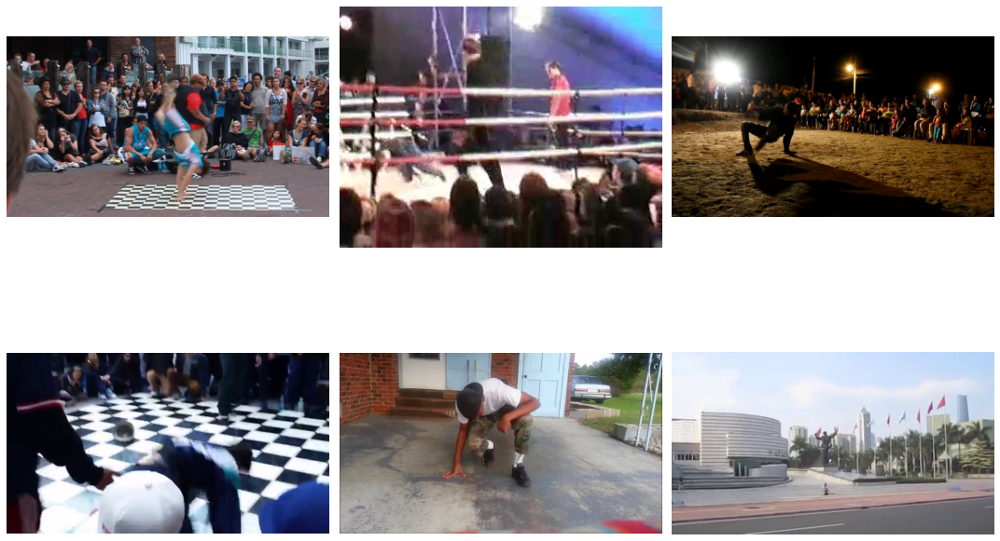

In [ ]:
breakdancing_dir = '/content/Dataset/train_images/breakdancing'
breakdancing = os.listdir(breakdancing_dir)

plt.figure(figsize=(15,15))

for i in range(6):
  plt.subplot(3, 3, i + 1)
  img = plt.imread(os.path.join(breakdancing_dir, breakdancing[i]))
  plt.imshow(img, cmap='gray')
  plt.axis('off')

plt.tight_layout()  

### -------------------------------------------------------------------CalliGraphy-------------------------------------------------------------------

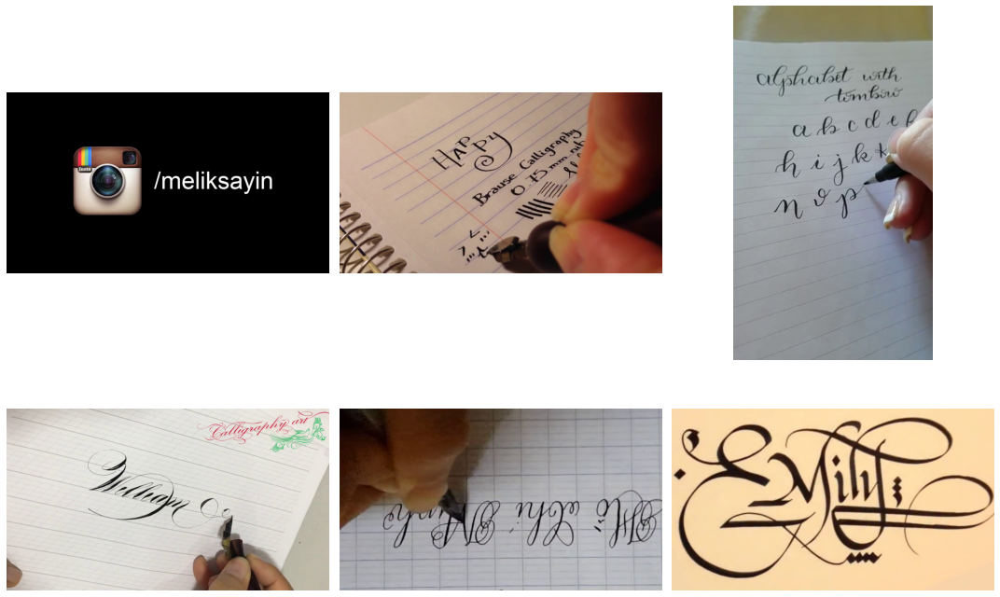

In [ ]:
calligraphy_dir = '/content/Dataset/train_images/calligraphy'
calligraphy = os.listdir(calligraphy_dir)

plt.figure(figsize=(15,15))

for i in range(6):
  plt.subplot(3, 3, i + 1)
  img = plt.imread(os.path.join(calligraphy_dir, calligraphy[i]))
  plt.imshow(img, cmap='gray')
  plt.axis('off')

plt.tight_layout()  

### -------------------------------------------------------------------Celebrating-------------------------------------------------------------------

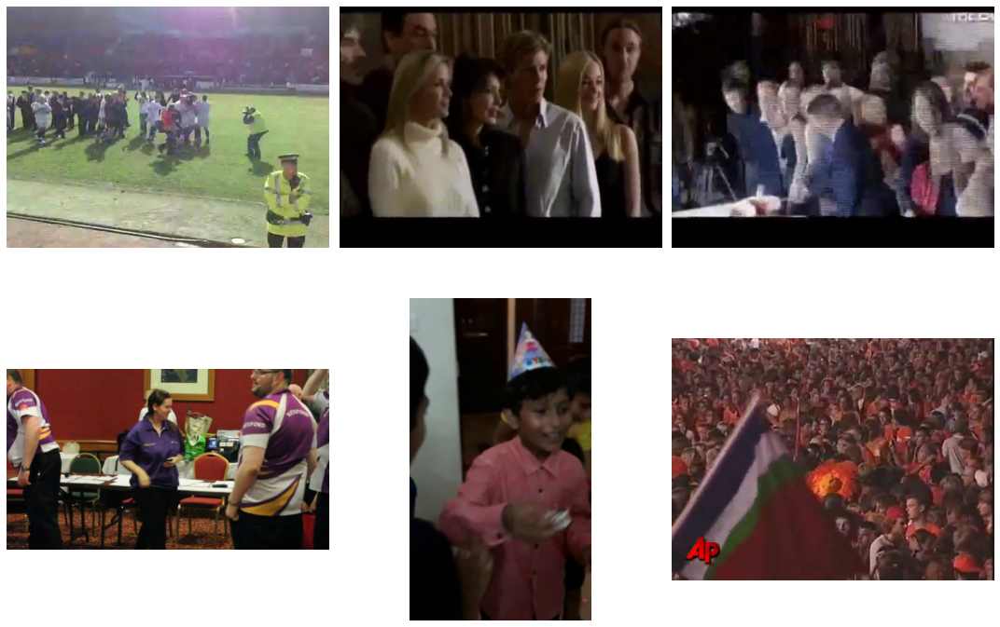

In [ ]:
celebrating_dir = '/content/Dataset/train_images/celebrating'
celebrating = os.listdir(celebrating_dir)

plt.figure(figsize=(15,15))

for i in range(6):
  plt.subplot(3, 3, i + 1)
  img = plt.imread(os.path.join(celebrating_dir, celebrating[i]))
  plt.imshow(img, cmap='gray')
  plt.axis('off')

plt.tight_layout()  

### -------------------------------------------------------------------Claypotterymaking-------------------------------------------------------------------

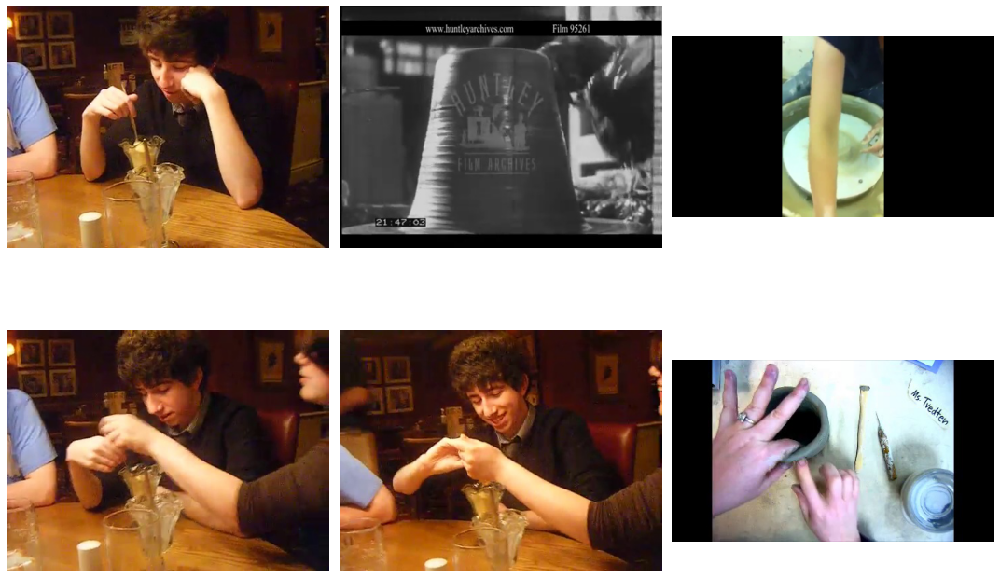

In [ ]:
claypotterymaking_dir = '/content/Dataset/train_images/claypotterymaking'
claypotterymaking = os.listdir(claypotterymaking_dir)

plt.figure(figsize=(15,15))

for i in range(6):
  plt.subplot(3, 3, i + 1)
  img = plt.imread(os.path.join(claypotterymaking_dir, claypotterymaking[i]))
  plt.imshow(img, cmap='gray')
  plt.axis('off')

plt.tight_layout()

### -------------------------------------------------------------------Climbingarope-------------------------------------------------------------------

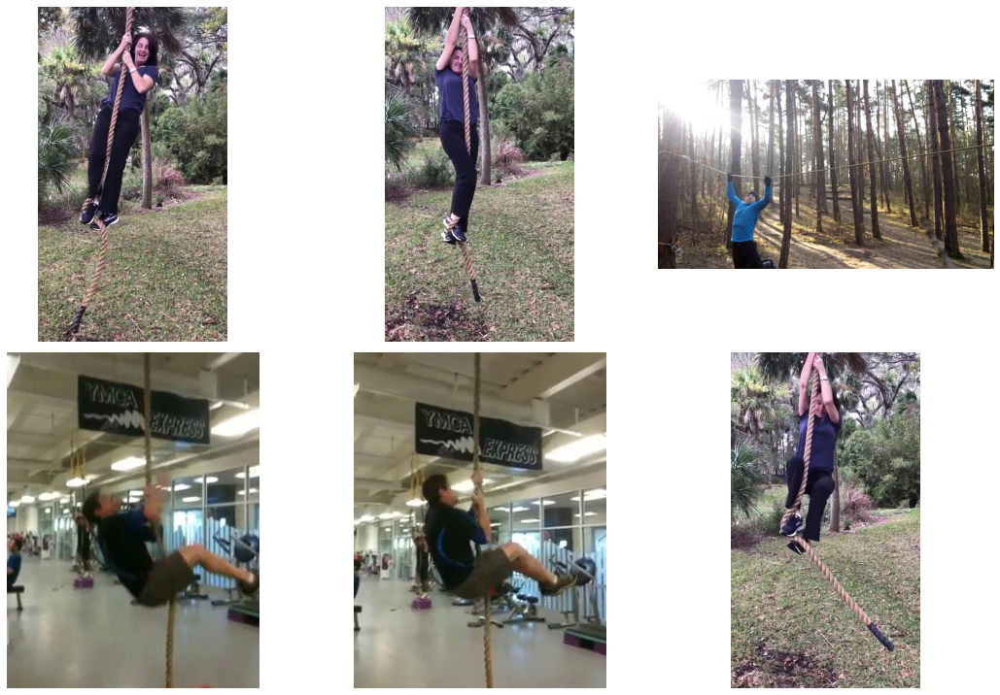

In [ ]:
climbingarope_dir = '/content/Dataset/train_images/climbingarope'
climbingarope = os.listdir(climbingarope_dir)

plt.figure(figsize=(15,15))

for i in range(6):
  plt.subplot(3, 3, i + 1)
  img = plt.imread(os.path.join(climbingarope_dir, climbingarope[i]))
  plt.imshow(img, cmap='gray')
  plt.axis('off')

plt.tight_layout()

### -------------------------------------------------------------------Cooking on campfire-------------------------------------------------------------------

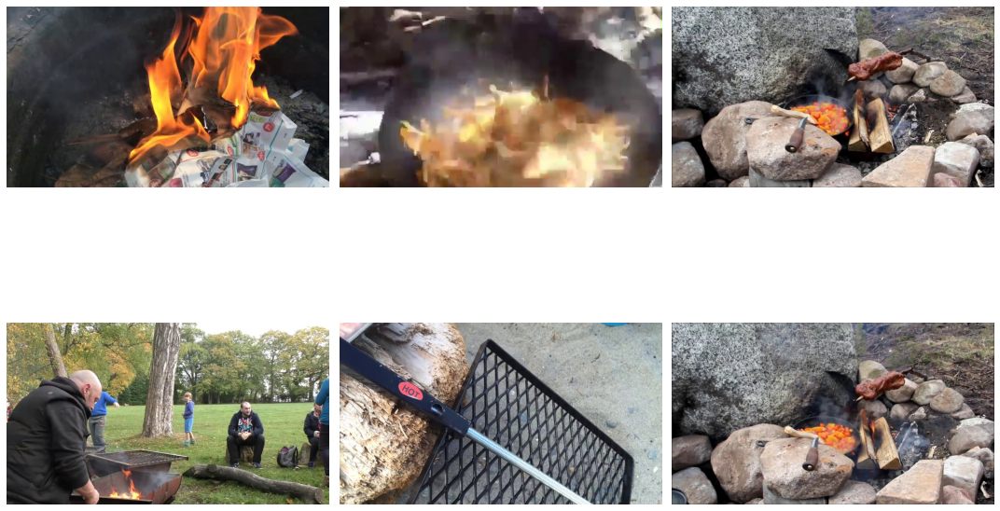

In [ ]:
cookingoncampfire_dir = '/content/Dataset/train_images/cookingoncampfire'
cookingoncampfire = os.listdir(cookingoncampfire_dir)

plt.figure(figsize=(15,15))

for i in range(6):
  plt.subplot(3, 3, i + 1)
  img = plt.imread(os.path.join(cookingoncampfire_dir, cookingoncampfire[i]))
  plt.imshow(img, cmap='gray')
  plt.axis('off')

plt.tight_layout()

### -------------------------------------------------------------------Eating Ice-cream-------------------------------------------------------------------

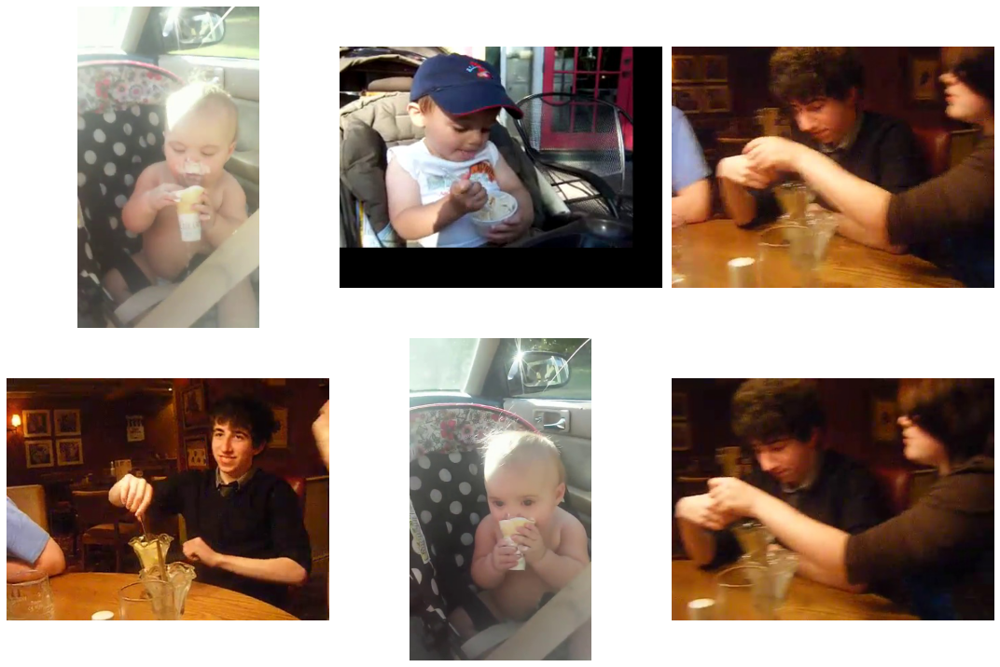

In [ ]:
eatingicecream_dir = '/content/Dataset/train_images/eatingicecream'
eatingicecream = os.listdir(eatingicecream_dir)

plt.figure(figsize=(15,15))

for i in range(6):
  plt.subplot(3, 3, i + 1)
  img = plt.imread(os.path.join(eatingicecream_dir, eatingicecream[i]))
  plt.imshow(img, cmap='gray')
  plt.axis('off')

plt.tight_layout()

### -------------------------------------------------------------------Golf Driving-------------------------------------------------------------------

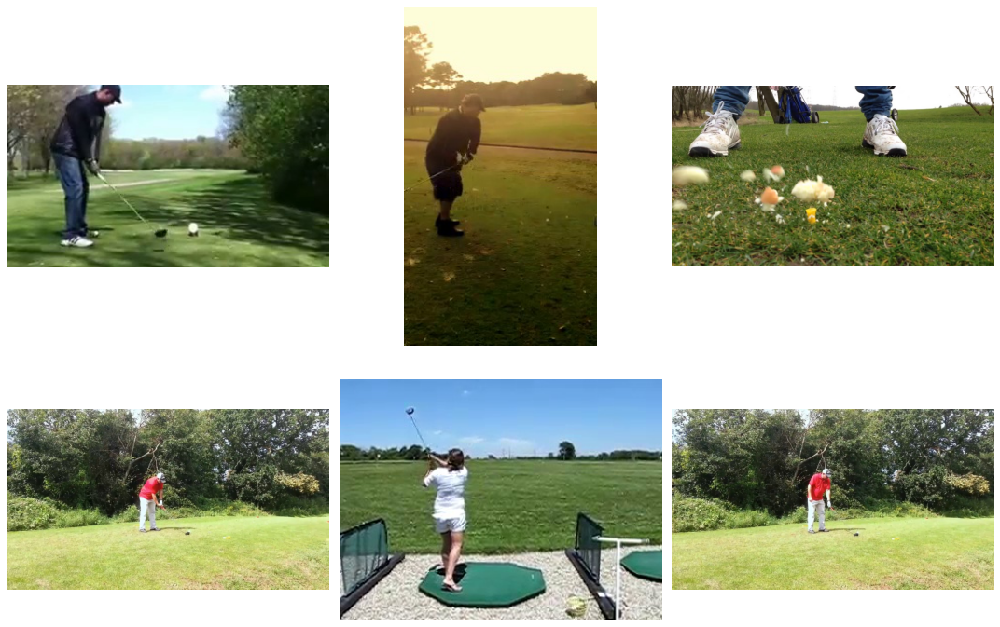

In [ ]:
golfdriving_dir = '/content/Dataset/train_images/golfdriving'
golfdriving = os.listdir(golfdriving_dir)

plt.figure(figsize=(15,15))

for i in range(6):
  plt.subplot(3, 3, i + 1)
  img = plt.imread(os.path.join(golfdriving_dir, golfdriving[i]))
  plt.imshow(img, cmap='gray')
  plt.axis('off')

plt.tight_layout()

### -------------------------------------------------------------------Pushup-------------------------------------------------------------------

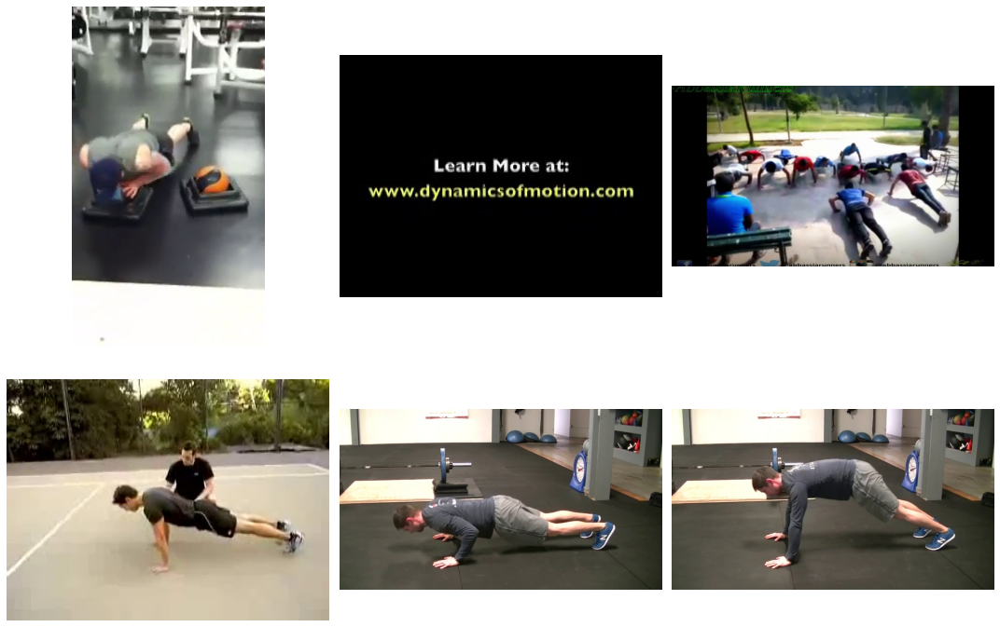

In [ ]:
pushup_dir = '/content/Dataset/train_images/pushup'
pushup = os.listdir(pushup_dir)

plt.figure(figsize=(15,15))

for i in range(6):
  plt.subplot(3, 3, i + 1)
  img = plt.imread(os.path.join(pushup_dir, pushup[i]))
  plt.imshow(img, cmap='gray')
  plt.axis('off')

plt.tight_layout()

### -------------------------------------------------------------------Raising eyebrows-------------------------------------------------------------------

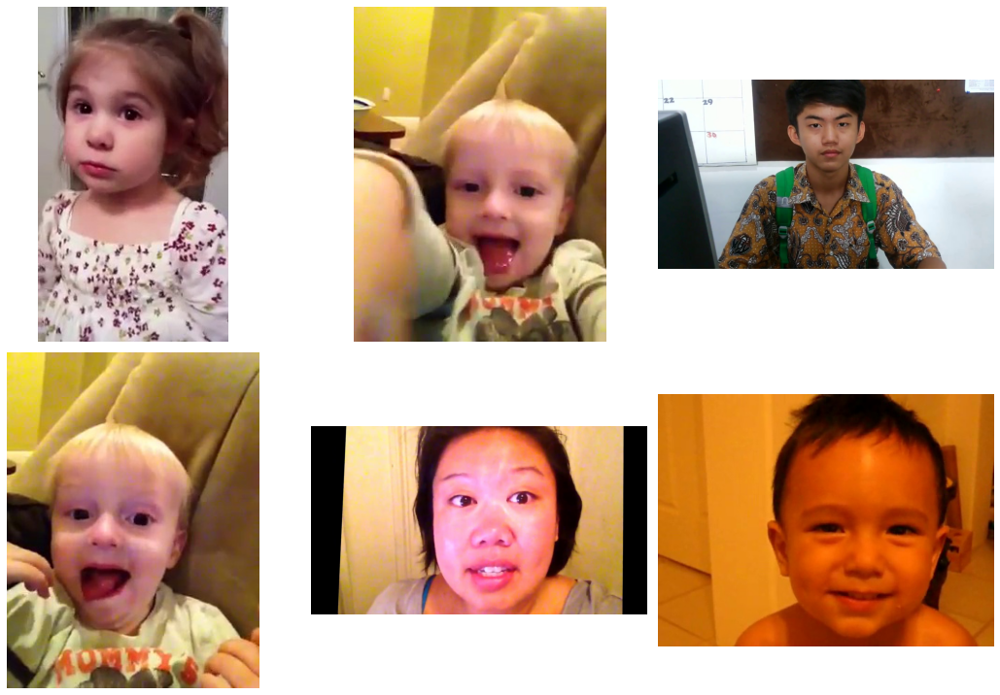

In [ ]:
raisingeyebrows_dir = '/content/Dataset/train_images/raisingeyebrows'
raisingeyebrows = os.listdir(raisingeyebrows_dir)

plt.figure(figsize=(15,15))

for i in range(6):
  plt.subplot(3, 3, i + 1)
  img = plt.imread(os.path.join(raisingeyebrows_dir, raisingeyebrows[i]))
  plt.imshow(img, cmap='gray')
  plt.axis('off')

plt.tight_layout()

### -------------------------------------------------------------------Riding Scooter-------------------------------------------------------------------

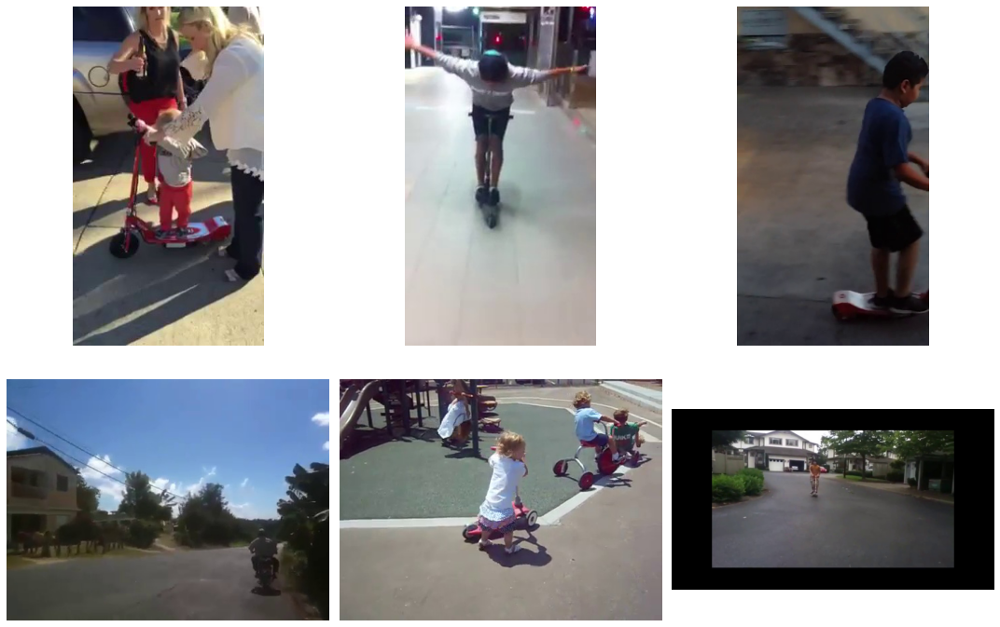

In [ ]:
ridingscooter_dir = '/content/Dataset/train_images/ridingscooter'
ridingscooter = os.listdir(ridingscooter_dir)

plt.figure(figsize=(15,15))

for i in range(6):
  plt.subplot(3, 3, i + 1)
  img = plt.imread(os.path.join(ridingscooter_dir, ridingscooter[i]))
  plt.imshow(img, cmap='gray')
  plt.axis('off')

plt.tight_layout()

# 4.1 Data Augmentation

# 5.1.1 Random Erasing Method

In [ ]:
# import numpy as np


# def get_random_eraser(p=0.5, s_l=0.02, s_h=0.4, r_1=0.3, r_2=1/0.3, v_l=0, v_h=255, pixel_level=False):
#     def eraser(input_img):
#         img_h, img_w, img_c = input_img.shape
#         p_1 = np.random.rand()

#         if p_1 > p:
#             return input_img

#         while True:
#             s = np.random.uniform(s_l, s_h) * img_h * img_w
#             r = np.random.uniform(r_1, r_2)
#             w = int(np.sqrt(s / r))
#             h = int(np.sqrt(s * r))
#             left = np.random.randint(0, img_w)
#             top = np.random.randint(0, img_h)

#             if left + w <= img_w and top + h <= img_h:
#                 break

#         if pixel_level:
#             c = np.random.uniform(v_l, v_h, (h, w, img_c))
#         else:
#             c = np.random.uniform(v_l, v_h)

#         input_img[top:top + h, left:left + w, :] = c

#         return input_img

#     return eraser

In [ ]:
Batch_size = 64
Image_size = 224
classes_list = ["breakdancing","calligraphy","celebrating","claypotterymaking", 
                "climbingarope","cookingoncampfire","eatingicecream","golfdriving",
                "pushup","raisingeyebrows","ridingscooter"]
output_size = len(classes_list)           

In [ ]:
#Train:
Train_generator = tf.keras.preprocessing.image_dataset_from_directory(Dataset_dir,
                                                                      labels="inferred",
                                                                      batch_size=Batch_size,
                                                                      color_mode="rgb",
                                                                      image_size=(Image_size,Image_size),
                                                                      validation_split=0.2,
                                                                      subset='training',
                                                                      shuffle=True,
                                                                      seed=25)

#Validation:
Validation_generator = tf.keras.preprocessing.image_dataset_from_directory(Dataset_dir,
                                                                           labels="inferred",
                                                                           batch_size=Batch_size,
                                                                           color_mode="rgb",
                                                                           image_size=(Image_size,Image_size),
                                                                           validation_split=0.2,
                                                                           subset='validation',
                                                                           shuffle=True,
                                                                           seed=25)

Found 29600 files belonging to 11 classes.
Using 23680 files for training.
Found 29600 files belonging to 11 classes.
Using 5920 files for validation.


In [ ]:
Train_generator.class_names

['breakdancing',
 'calligraphy',
 'celebrating',
 'claypotterymaking',
 'climbingarope',
 'cookingoncampfire',
 'eatingicecream',
 'golfdriving',
 'pushup',
 'raisingeyebrows',
 'ridingscooter']

# 5.Modeling

# 5.1 Model - 1 (Custom CNN)

In [ ]:
def human_action_recognition_model():

  input_layer = tf.keras.Input(shape=(Image_size,Image_size,3))
  
  #First-Block
  conv_1 = tf.keras.layers.Conv2D(filters=64,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(input_layer)

  conv_2 = tf.keras.layers.Conv2D(filters=64,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(conv_1)                                


  maxpool_1 = tf.keras.layers.MaxPool2D(pool_size=(2,2))(conv_2)
  
  #Second-Block
  conv_3 = tf.keras.layers.Conv2D(filters=128,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(maxpool_1)

  conv_4 = tf.keras.layers.Conv2D(filters=128,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(conv_3)                                

  maxpool_2 = tf.keras.layers.MaxPool2D(pool_size=(2,2))(conv_4)
  
  #Third-Block
  conv_5 = tf.keras.layers.Conv2D(filters=256,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(maxpool_2)

  conv_6 = tf.keras.layers.Conv2D(filters=256,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(conv_5)  

  conv_7 = tf.keras.layers.Conv2D(filters=256,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(conv_6)                                                               

  maxpool_3 = tf.keras.layers.MaxPool2D(pool_size=(2,2))(conv_7)

  #Forth Block
  conv_8 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(maxpool_3)

  conv_9 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(conv_8)  

  conv_10 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(conv_9)                                                               
  
  maxpool_4 = tf.keras.layers.MaxPool2D(pool_size=(2,2))(conv_10)
  
  #Fifth Block
  conv_11 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(maxpool_4)

  conv_12 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(conv_11)  

  conv_13 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(conv_12)                                                               
  
  maxpool_5 = tf.keras.layers.MaxPool2D(pool_size=(2,2))(conv_13)

  flatten_layer = tf.keras.layers.Flatten()(maxpool_5)

  dense_1 = tf.keras.layers.Dense(512, activation='relu')(flatten_layer)
  
  batchnorm_1 = tf.keras.layers.BatchNormalization()(dense_1)

  dropout_1 = tf.keras.layers.Dropout(0.5)(batchnorm_1)
  
  dense_2 = tf.keras.layers.Dense(256, activation='relu')(dropout_1)
  
  batchnorm_2 = tf.keras.layers.BatchNormalization()(dense_2)

  dropout_2 = tf.keras.layers.Dropout(0.5)(batchnorm_2)

  dense_3 = tf.keras.layers.Dense(128, activation='relu')(dropout_2)
  
  batchnorm_3 = tf.keras.layers.BatchNormalization()(dense_3)

  dropout_3 = tf.keras.layers.Dropout(0.5)(batchnorm_3)

  output_layer = tf.keras.layers.Dense(output_size, activation='softmax')(dropout_3)


  action_model = tf.keras.Model(inputs=input_layer, outputs=output_layer)

  return action_model

In [ ]:
model = human_action_recognition_model()

In [ ]:
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 224, 224, 64)      1792      
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 224, 224, 64)      36928     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 112, 112, 64)      0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 112, 112, 128)     73856     
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 112, 112, 128)     147584    
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 56, 56, 128)       0   

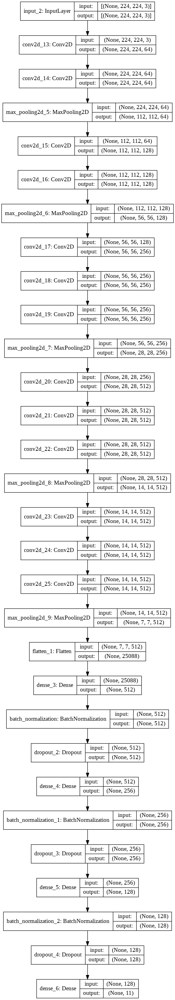

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True, to_file='Model.png')

### Compile the Model

In [ ]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

# Callbacks

In [ ]:
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath='/content/ModelCheckpoint/best_weights.hdf5',
                                                      save_best_only=True, 
                                                      monitor='val_accuracy',
                                                      mode='max',
                                                      verbose=1)

tensorboard = tf.keras.callbacks.TensorBoard(log_dir='/content/logs')

# Let's Start the Training

In [ ]:
history = model.fit(Train_generator, 
                    epochs=15, 
                    batch_size=Batch_size, 
                    validation_data=Validation_generator, 
                    callbacks=[model_checkpoint, tensorboard])

Epoch 1/15
370/370 [==============================] - 163s 434ms/step - loss: 2.7003 - accuracy: 0.2227 - val_loss: 3.2517 - val_accuracy: 0.1492

Epoch 00001: val_accuracy did not improve from 0.98530
Epoch 2/15
370/370 [==============================] - 161s 432ms/step - loss: 1.7523 - accuracy: 0.4519 - val_loss: 1.1789 - val_accuracy: 0.6581

Epoch 00002: val_accuracy did not improve from 0.98530
Epoch 3/15
370/370 [==============================] - 161s 432ms/step - loss: 1.0536 - accuracy: 0.6626 - val_loss: 0.6822 - val_accuracy: 0.8108

Epoch 00003: val_accuracy did not improve from 0.98530
Epoch 4/15
370/370 [==============================] - 161s 432ms/step - loss: 0.5539 - accuracy: 0.8334 - val_loss: 0.2891 - val_accuracy: 0.9373

Epoch 00004: val_accuracy did not improve from 0.98530
Epoch 5/15
370/370 [==============================] - 161s 433ms/step - loss: 0.3170 - accuracy: 0.9123 - val_loss: 0.1832 - val_accuracy: 0.9650

Epoch 00005: val_accuracy did not improve fro

## Save the model

In [ ]:
model.save('My_Model.h5')

### Test our model

In [ ]:
test_loss, test_accuracy = model.evaluate(Validation_generator)

test_loss = round(test_loss, 7)
test_accuracy = round(test_accuracy*100, 3)

print('Test Loss: ', test_loss)
print('Test Accuracy:', '\033[0m', test_accuracy,'%\033[0m')

93/93 [==============================] - 13s 130ms/step - loss: 0.0425 - accuracy: 0.9858
Test Loss:  0.0425473
Test Accuracy:  98.581 %


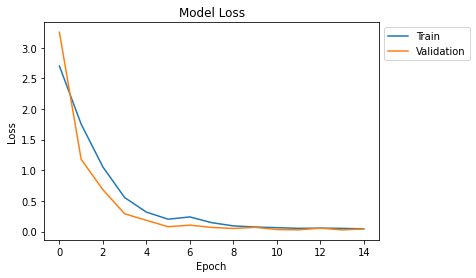

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left', bbox_to_anchor=(1,1))
plt.show()

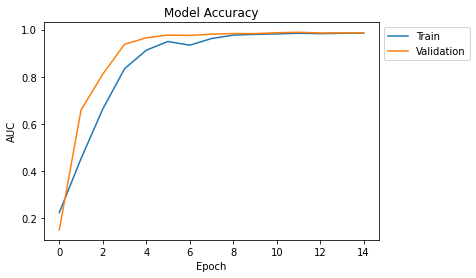

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('AUC')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left', bbox_to_anchor=(1,1))
plt.show()

### Tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/logs'

<IPython.core.display.Javascript object>

# Model - 2

In [ ]:
def human_action_recognition_model_1():

  input_layer = tf.keras.Input(shape=(Image_size,Image_size,3))
  
  #First-Block
  conv_1 = tf.keras.layers.Conv2D(filters=64,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(input_layer)
  
  batchnorm_1 = tf.keras.layers.BatchNormalization()(conv_1)

  dropout_1 = tf.keras.layers.Dropout(0.1)(batchnorm_1)

  conv_2 = tf.keras.layers.Conv2D(filters=64,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(dropout_1)                                

  batchnorm_2 = tf.keras.layers.BatchNormalization()(conv_2)

  dropout_2 = tf.keras.layers.Dropout(0.1)(batchnorm_2)

  maxpool_1 = tf.keras.layers.MaxPool2D(pool_size=(2,2))(dropout_2)
  
  #Second-Block
  conv_3 = tf.keras.layers.Conv2D(filters=128,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(maxpool_1)
  
  batchnorm_3 = tf.keras.layers.BatchNormalization()(conv_3)

  dropout_3 = tf.keras.layers.Dropout(0.1)(batchnorm_3)

  conv_4 = tf.keras.layers.Conv2D(filters=128,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(dropout_3)                                
  
  batchnorm_4 = tf.keras.layers.BatchNormalization()(conv_4)

  dropout_4 = tf.keras.layers.Dropout(0.1)(batchnorm_4)

  maxpool_2 = tf.keras.layers.MaxPool2D(pool_size=(2,2))(dropout_4)
  
  #Third-Block
  conv_5 = tf.keras.layers.Conv2D(filters=256,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(maxpool_2)
  
  batchnorm_5 = tf.keras.layers.BatchNormalization()(conv_5)

  dropout_5 = tf.keras.layers.Dropout(0.1)(batchnorm_5)

  conv_6 = tf.keras.layers.Conv2D(filters=256,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(dropout_5)  
  
  batchnorm_6 = tf.keras.layers.BatchNormalization()(conv_6)

  dropout_6 = tf.keras.layers.Dropout(0.1)(batchnorm_6)

  conv_7 = tf.keras.layers.Conv2D(filters=256,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(dropout_6)                                                               
  
  batchnorm_7 = tf.keras.layers.BatchNormalization()(conv_7)

  dropout_7 = tf.keras.layers.Dropout(0.1)(batchnorm_7)

  maxpool_3 = tf.keras.layers.MaxPool2D(pool_size=(2,2))(dropout_7)

  #Forth Block
  conv_8 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(maxpool_3)
  
  batchnorm_8 = tf.keras.layers.BatchNormalization()(conv_8)

  dropout_8 = tf.keras.layers.Dropout(0.1)(batchnorm_8)

  conv_9 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(dropout_8)  
  
  batchnorm_9 = tf.keras.layers.BatchNormalization()(conv_9)

  dropout_9 = tf.keras.layers.Dropout(0.1)(batchnorm_9)

  conv_10 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(dropout_9)      

  batchnorm_10 = tf.keras.layers.BatchNormalization()(conv_10)

  dropout_10 = tf.keras.layers.Dropout(0.1)(batchnorm_10)

  maxpool_4 = tf.keras.layers.MaxPool2D(pool_size=(2,2))(dropout_10)
  
  #Fifth Block
  conv_11 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(maxpool_4)
  
  batchnorm_11 = tf.keras.layers.BatchNormalization()(conv_11)

  dropout_11 = tf.keras.layers.Dropout(0.1)(batchnorm_11)

  conv_12 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(dropout_11)  
  
  batchnorm_12 = tf.keras.layers.BatchNormalization()(conv_12)

  dropout_12 = tf.keras.layers.Dropout(0.1)(batchnorm_12)

  conv_13 = tf.keras.layers.Conv2D(filters=512,
                                  kernel_size=(3,3),
                                  padding='same',
                                  activation='relu')(dropout_12)                                                               
  
  maxpool_5 = tf.keras.layers.MaxPool2D(pool_size=(2,2))(conv_13)



  flatten_layer = tf.keras.layers.Flatten()(maxpool_5)                               

  dense_1 = tf.keras.layers.Dense(1024, activation='relu',kernel_initializer='he_uniform')(flatten_layer)
  
  batchnorm_1 = tf.keras.layers.BatchNormalization()(dense_1)

  dropout_1 = tf.keras.layers.Dropout(0.3)(batchnorm_1)
  
  dense_2 = tf.keras.layers.Dense(512, activation='relu',kernel_initializer='he_uniform')(dropout_1)
  
  batchnorm_2 = tf.keras.layers.BatchNormalization()(dense_2)

  dropout_2 = tf.keras.layers.Dropout(0.5)(batchnorm_2)

  dense_3 = tf.keras.layers.Dense(256, activation='relu',kernel_initializer='he_uniform')(dropout_2)
  
  batchnorm_3 = tf.keras.layers.BatchNormalization()(dense_3)

  dropout_3 = tf.keras.layers.Dropout(0.3)(batchnorm_3)

  dense_4 = tf.keras.layers.Dense(256, activation='relu',kernel_initializer='he_uniform')(dropout_3)
  
  batchnorm_4 = tf.keras.layers.BatchNormalization()(dense_4)

  dropout_4 = tf.keras.layers.Dropout(0.5)(batchnorm_4)

  output_layer = tf.keras.layers.Dense(output_size, activation='softmax')(dropout_4)


  action_model_1 = tf.keras.Model(inputs=input_layer, outputs=output_layer)

  return action_model_1

In [ ]:
model_1 = human_action_recognition_model_1()

In [ ]:
model_1.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 224, 224, 64)      1792      
_________________________________________________________________
batch_normalization (BatchNo (None, 224, 224, 64)      256       
_________________________________________________________________
dropout (Dropout)            (None, 224, 224, 64)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 224, 224, 64)      36928     
_________________________________________________________________
batch_normalization_1 (Batch (None, 224, 224, 64)      256       
_________________________________________________________________
dropout_1 (Dropout)          (None, 224, 224, 64)      0     

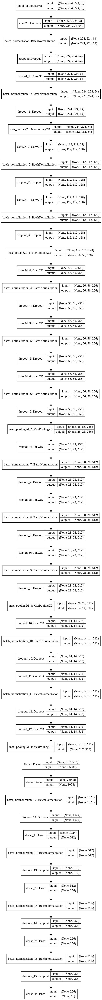

In [ ]:
plot_model(model_1, show_shapes=True, show_layer_names=True, to_file='Model_1.png')

### Compile the Model

In [ ]:
model_1.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

## Callbacks

In [ ]:
from tensorflow.keras.models import load_model

model_1 = load_model('/content/drive/MyDrive/Technocolabs_Internship_Project/ModelCheckpoint/best_weights_1.hdf5')

In [ ]:
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath='/content/ModelCheckpoint/best_weights_1.hdf5',
                                                      save_best_only=True, 
                                                      monitor='val_accuracy',
                                                      mode='max',
                                                      verbose=1)

# tensorboard = tf.keras.callbacks.TensorBoard(log_dir='/content/logs')

#Let's start the training

In [ ]:
history_1 = model_1.fit(Train_generator, 
                        epochs=15, 
                        batch_size=Batch_size, 
                        validation_data=Validation_generator, 
                        callbacks=[model_checkpoint])

Epoch 1/15
370/370 [==============================] - 228s 612ms/step - loss: 0.0305 - accuracy: 0.9849 - val_loss: 0.1649 - val_accuracy: 0.9498

Epoch 00001: val_accuracy improved from -inf to 0.94983, saving model to /content/ModelCheckpoint/best_weights_1.hdf5
Epoch 2/15
370/370 [==============================] - 225s 606ms/step - loss: 0.0256 - accuracy: 0.9863 - val_loss: 0.1246 - val_accuracy: 0.9691

Epoch 00002: val_accuracy improved from 0.94983 to 0.96909, saving model to /content/ModelCheckpoint/best_weights_1.hdf5
Epoch 3/15
370/370 [==============================] - 225s 607ms/step - loss: 0.0218 - accuracy: 0.9880 - val_loss: 0.2876 - val_accuracy: 0.9399

Epoch 00003: val_accuracy did not improve from 0.96909
Epoch 4/15
370/370 [==============================] - 225s 606ms/step - loss: 0.0336 - accuracy: 0.9832 - val_loss: 0.4115 - val_accuracy: 0.9015

Epoch 00004: val_accuracy did not improve from 0.96909
Epoch 5/15
370/370 [==============================] - 225s 607m